In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sys
import os
import scipy.io
import scipy.misc
from PIL import Image
import pprint

In [2]:
pp = pprint.PrettyPrinter(indent = 4)
img_size = 400
vgg = tf.keras.applications.VGG19(include_top= False,
                                 weights= 'imagenet',
                                 input_shape = (img_size, img_size, 3))

vgg.trainable = False
pp.pprint(vgg)

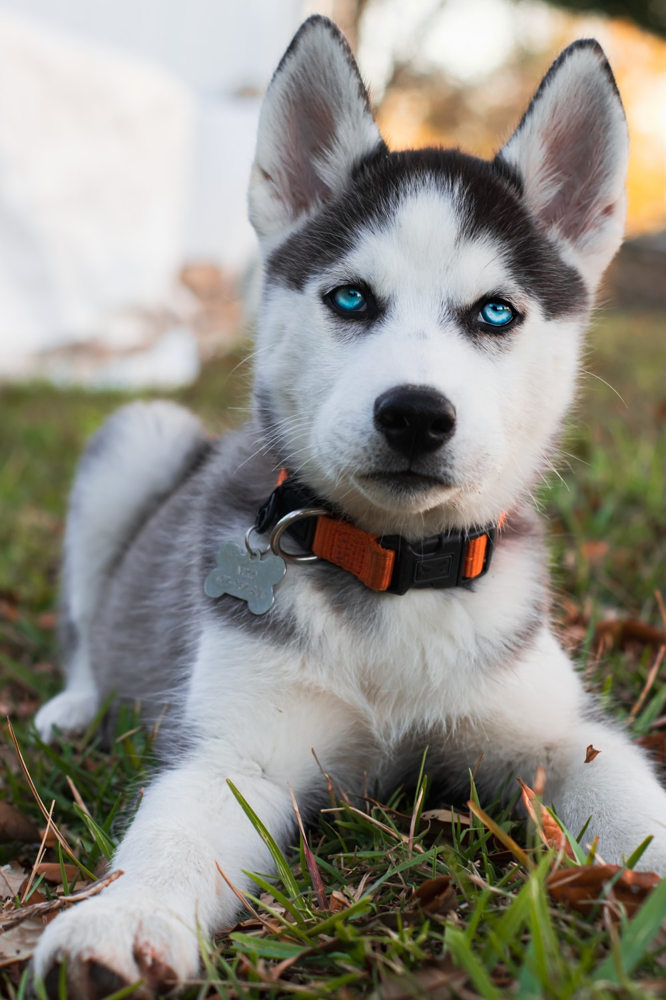

In [16]:
content_image = Image.open('images/content/Husky.jpg')
content_image

In [3]:
def compute_content_cost(content_output, generated_output):
    
    a_C = content_output[-1]
    a_G = generated_output[-1]
    
    #getting dimensions of a_G
    _, n_H, n_W, n_C = a_G.get_shape().as_list()
    
    #unrolling a_C
    unrolled_a_C = tf.transpose(tf.reshape(a_C, shape = [n_H * n_W, n_C]))
    
    #unrolling a_G
    unrolled_a_G = tf.transpose(tf.reshape(a_G, shape = [n_H * n_W, n_C]))
    
    #computing content cost
    J_content = (1/ (4 * n_H * n_W * n_C) * tf.reduce_sum(tf.square(tf.subtract(unrolled_a_C, unrolled_a_G))))
    
    return J_content

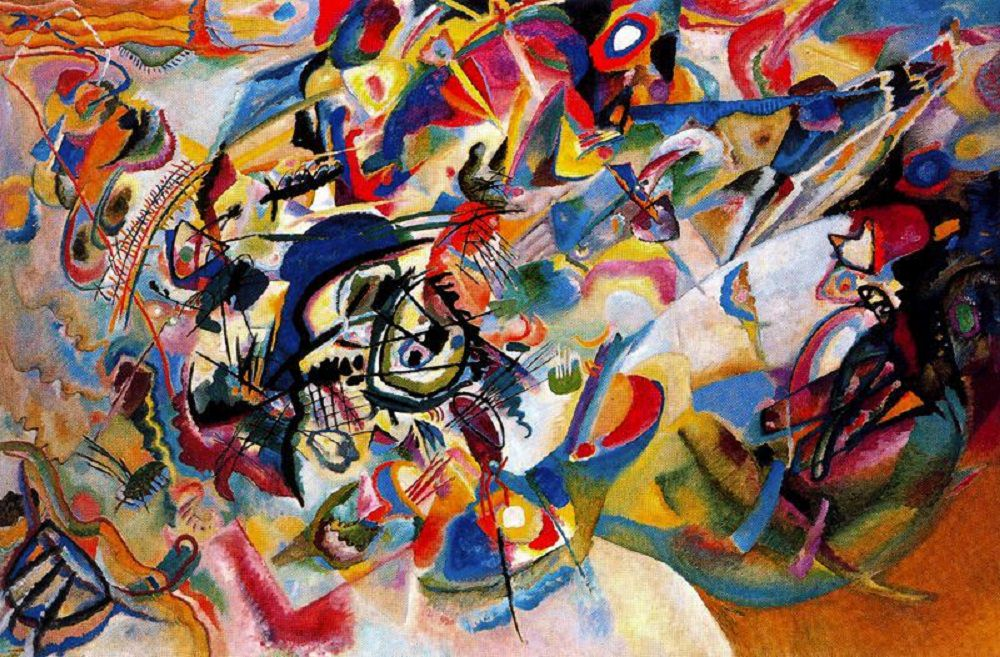

In [98]:
example = Image.open('images/style/Vassily_Kandinsky,_1913.jpg')
example

In [4]:
def gram_matrix(A):
    
    #multiply A matrix with A transpose
    GA = tf.matmul(A, tf.transpose(A))
    
    return GA

In [5]:
def compute_layer_style_cost(a_S, a_G):
    
    #storing dimensions of a_G
    _, n_H, n_W, n_C = a_G.get_shape().as_list()
    
    #unrolling a_S
    unrolled_a_S = tf.transpose(tf.reshape(a_S, shape = [n_H * n_W, n_C]))
    
    #unrolling a_G
    unrolled_a_G = tf.transpose(tf.reshape(a_G, shape = [n_H * n_W, n_C]))
    
    #computing gram_matrices of S and G
    GS = gram_matrix(unrolled_a_S)
    GG = gram_matrix(unrolled_a_G)
    
    #computing style layer cost
    J_style_layer = (1/ (4 * n_C** 2 * (n_H * n_W) ** 2) * tf.reduce_sum(tf.square(tf.subtract(GS, GG))))
    
    return J_style_layer

In [22]:
for layer in vgg.layers:
    print(layer.name)

input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [23]:
vgg.get_layer('block5_conv4').output

<KerasTensor: shape=(None, 25, 25, 512) dtype=float32 (created by layer 'block5_conv4')>

In [7]:
STYLE_LAYERS = [
    ('block1_conv1', 0.2),
    ('block2_conv1', 0.2),
    ('block3_conv1', 0.2),
    ('block4_conv1', 0.2),
    ('block5_conv1', 0.2)
]

In [8]:
def compute_style_cost(style_image_output, generated_image_output, STYLE_LAYERS=STYLE_LAYERS):
    
    #initialize overall style cost
    J_style = 0
    
    # Set a_S to be the hidden layer activation from the layer we have selected.
    # The last element of the array contains the content layer image, which must not be used.
    a_S = style_image_output[:-1]
    
    # Set a_G to be the output of the choosen hidden layers.
    # The last element of the list contains the content layer image which must not be used
    a_G = generated_image_output[:-1]
    
    for i, weight in zip(range(len(a_S)), STYLE_LAYERS):
        
        #computing style cost for current layer
        J_style_layer = compute_layer_style_cost(a_S[i], a_G[i])
        
        #Add weight * J_style_layer to this layer overall cost
        J_style += weight[1]* J_style_layer
        
    return J_style

In [9]:
def total_cost(J_content, J_style, alpha = 10, beta = 40):
    
    #computing total cost
    total_cost = alpha * J_content + beta * J_style
    
    return total_cost

(1, 400, 400, 3)


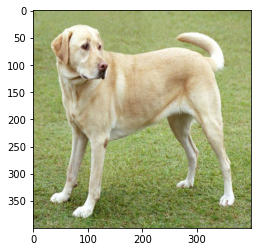

In [100]:
content_Image = np.array(Image.open('images/content/content-3.jpg').resize((img_size, img_size)))
content_Image = tf.constant(np.reshape(content_Image,((1,) + content_Image.shape)))

print(content_Image.shape)
plt.imshow(content_Image[0])
plt.show()

(1, 400, 400, 3)


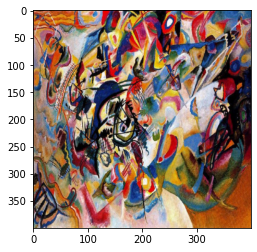

In [101]:
style_Image = np.array(Image.open('images/style/Vassily_Kandinsky,_1913.jpg').resize((img_size, img_size)))
style_Image = tf.constant(np.reshape(style_Image, ((1,) + style_Image.shape)))

print(style_Image.shape)
plt.imshow(style_Image[0])
plt.show()

(1, 400, 400, 3)


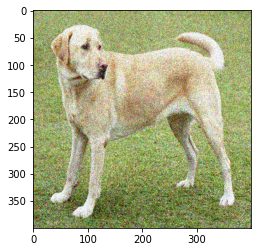

In [102]:
generated_image = tf.Variable(tf.image.convert_image_dtype(content_Image, tf.float32))
noise = tf.random.uniform(tf.shape(generated_image), -0.25, 0.25)
generated_image = tf.add(generated_image, noise)
generated_image = tf.clip_by_value(generated_image, clip_value_min = 0.0, clip_value_max = 1.0)

print(generated_image.shape)
plt.imshow(generated_image[0])
plt.show()

In [10]:
def get_layer_output(vgg, layer_names):
    
    outputs = [vgg.get_layer(layer[0]).output for layer in layer_names]
    
    model = tf.keras.Model([vgg.input], outputs)
    return model

In [39]:
content_layer =[('block5_conv4', 1)]

vgg_model_outputs = get_layer_output(vgg, STYLE_LAYERS + content_layer)

In [103]:
content_target = vgg_model_outputs(content_Image)  #Content encoder
style_target = vgg_model_outputs(style_Image)  #Style encoder

In [104]:
preprocessed_style = tf.Variable(tf.image.convert_image_dtype(content_Image, tf.float32))
a_C = vgg_model_outputs(preprocessed_style)

In [105]:
preprocessed_style = tf.Variable(tf.image.convert_image_dtype(style_Image, tf.float32))
a_S = vgg_model_outputs(preprocessed_style)

In [11]:
def clip_0_1(image):
    
    return tf.clip_by_value(image, clip_value_min = 0.0, clip_value_max = 1.0)

def tensor_to_image(tensor):
    
    tensor = tensor * 255
    tensor = np.array(tensor, dtype = np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return Image.fromarray(tensor)

In [26]:
@tf.function()
def train_step(generated_image, optimizer):
    with tf.GradientTape() as tape:
        
        a_G = vgg_model_outputs(generated_image)
        
        J_style = compute_style_cost(a_S, a_G)
        
        J_content = compute_content_cost(a_C, a_G)
        
        J = total_cost(J_content, J_style)
        
    grad = tape.gradient(J, generated_image)
    
    optimizer.apply_gradients([(grad, generated_image)])
    generated_image.assign(clip_0_1(generated_image))
    
    return J

Epoch 0


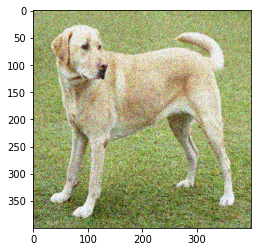

Epoch 250


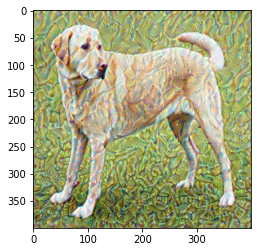

Epoch 500


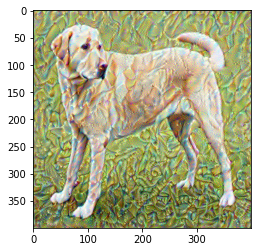

Epoch 750


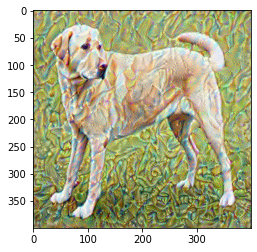

Epoch 1000


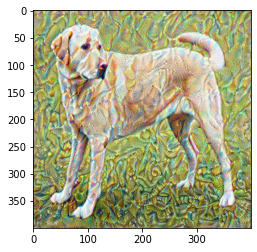

Epoch 1250


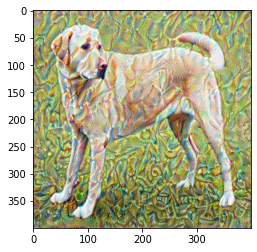

Epoch 1500


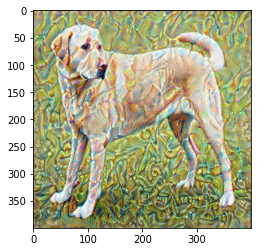

Epoch 1750


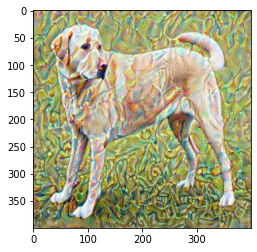

Epoch 2000


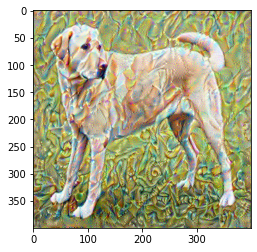

Epoch 2250


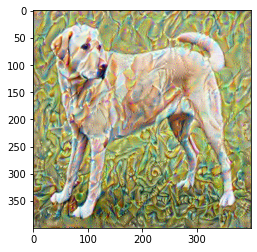

Epoch 2500


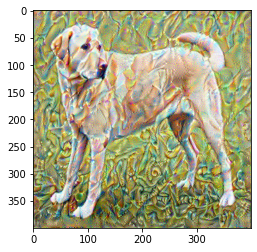

Epoch 2750


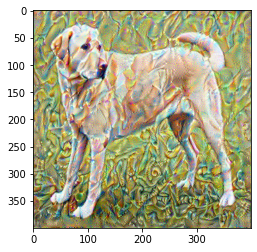

Epoch 3000


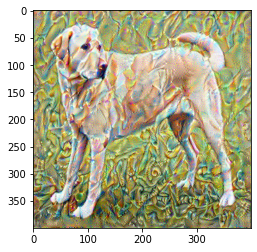

Epoch 3250


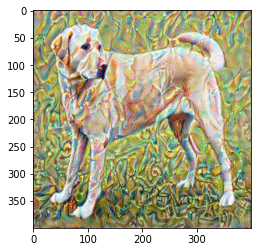

Epoch 3500


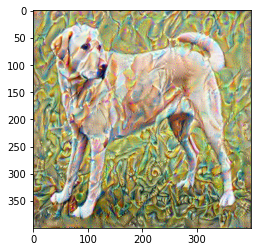

Epoch 3750


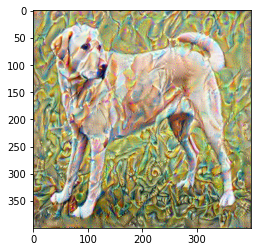

Epoch 4000


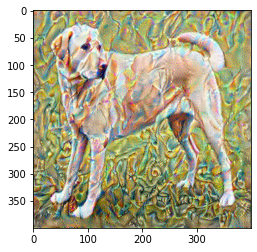

Epoch 4250


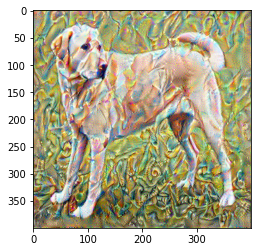

Epoch 4500


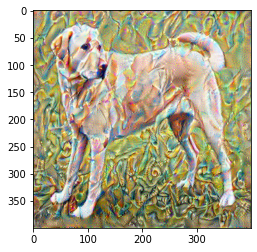

Epoch 4750


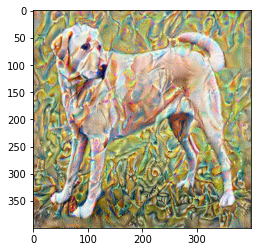

Epoch 5000


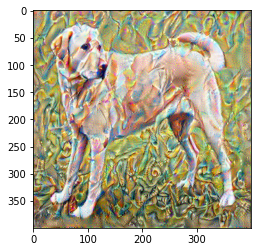

Epoch 5250


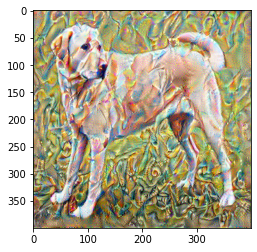

Epoch 5500


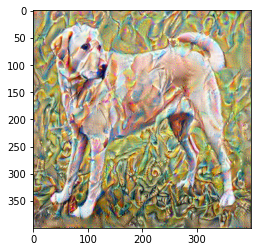

Epoch 5750


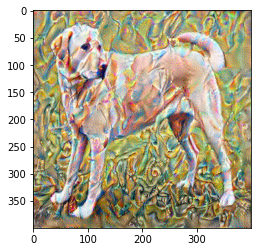

Epoch 6000


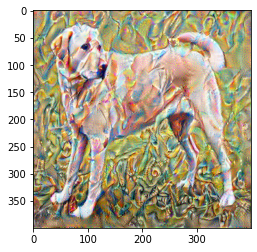

Epoch 6250


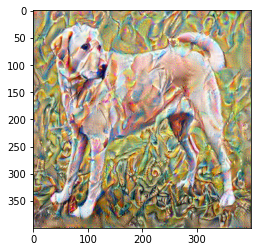

Epoch 6500


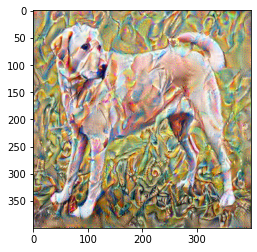

Epoch 6750


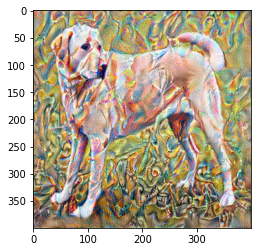

Epoch 7000


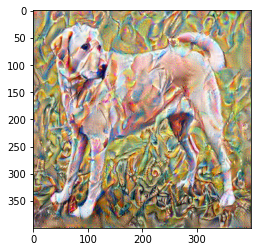

Epoch 7250


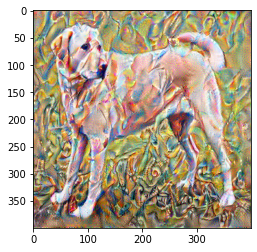

Epoch 7500


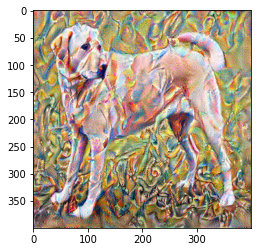

Epoch 7750


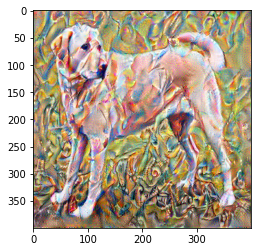

Epoch 8000


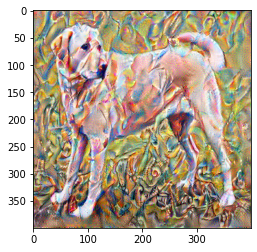

Epoch 8250


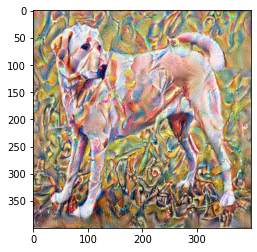

Epoch 8500


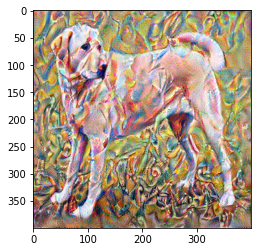

Epoch 8750


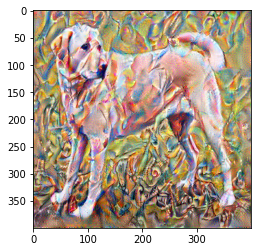

Epoch 9000


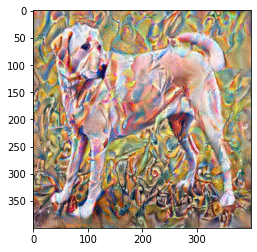

Epoch 9250


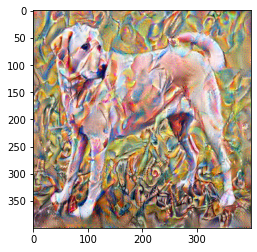

Epoch 9500


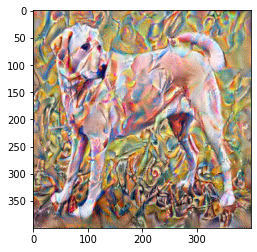

Epoch 9750


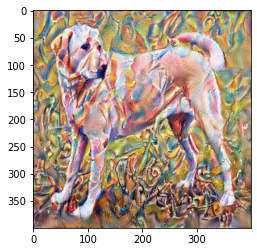

Epoch 10000


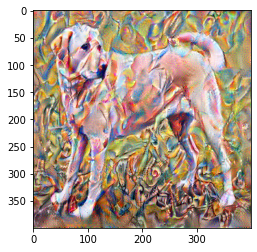

Epoch 10250


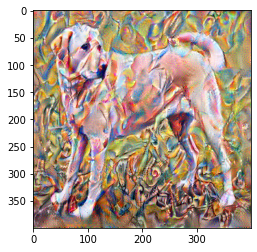

Epoch 10500


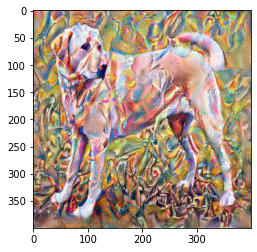

Epoch 10750


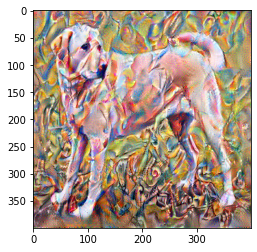

Epoch 11000


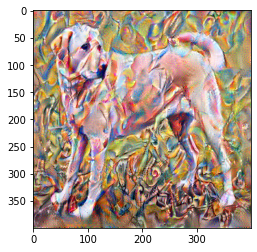

Epoch 11250


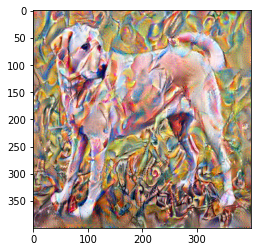

Epoch 11500


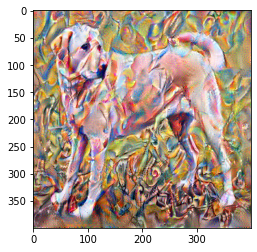

Epoch 11750


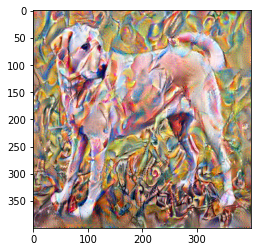

Epoch 12000


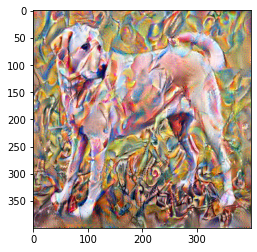

Epoch 12250


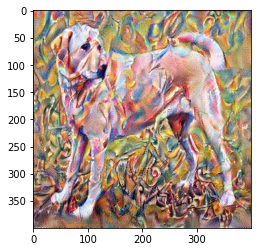

Epoch 12500


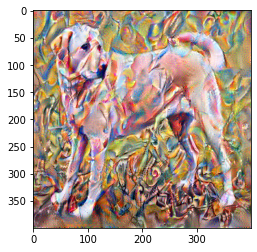

Epoch 12750


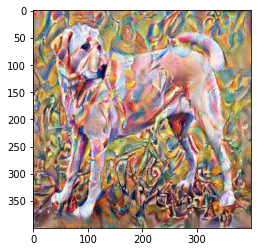

Epoch 13000


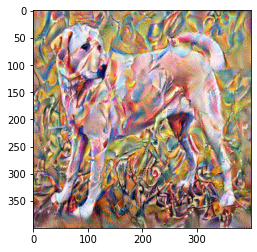

Epoch 13250


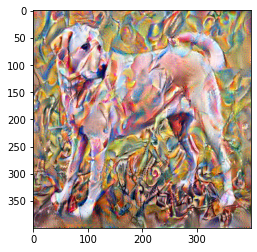

Epoch 13500


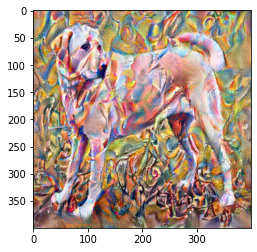

Epoch 13750


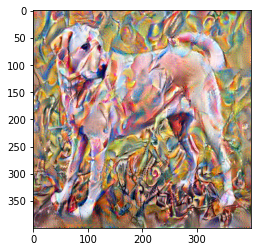

Epoch 14000


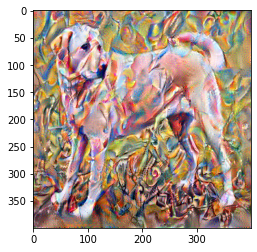

Epoch 14250


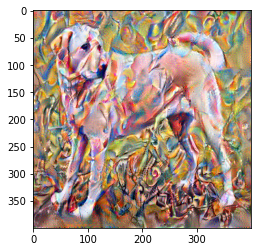

Epoch 14500


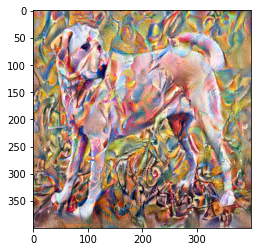

Epoch 14750


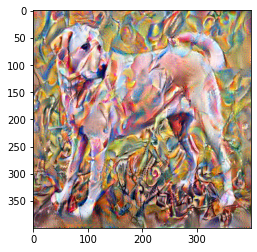

Epoch 15000


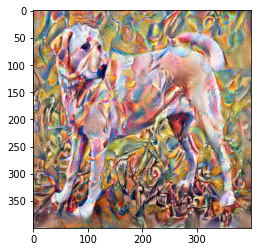

Epoch 15250


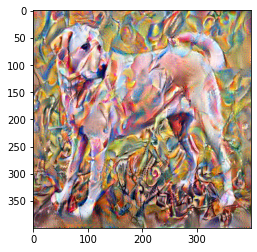

Epoch 15500


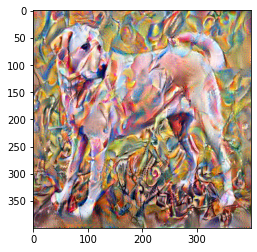

Epoch 15750


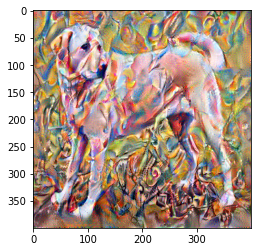

Epoch 16000


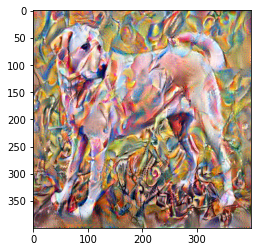

Epoch 16250


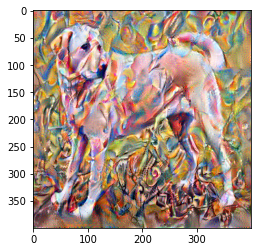

Epoch 16500


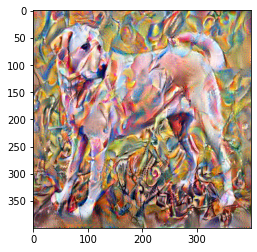

Epoch 16750


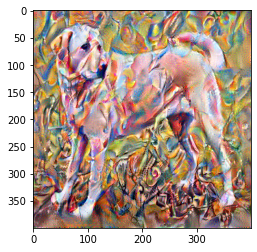

Epoch 17000


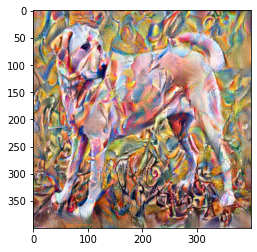

Epoch 17250


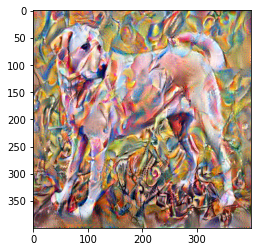

Epoch 17500


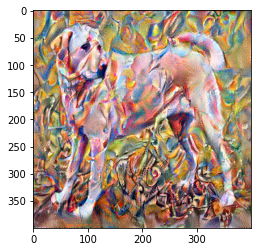

Epoch 17750


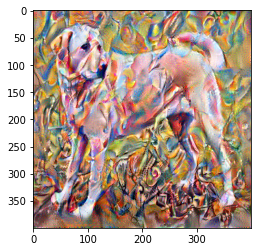

Epoch 18000


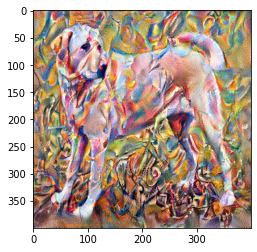

Epoch 18250


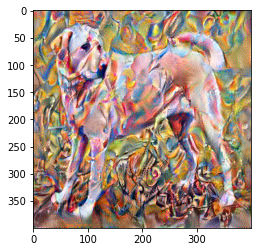

Epoch 18500


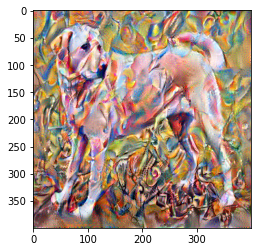

Epoch 18750


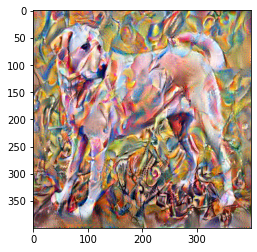

Epoch 19000


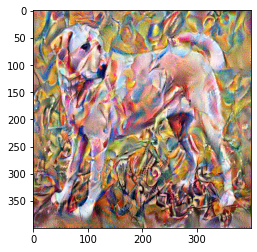

Epoch 19250


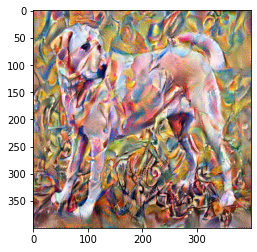

Epoch 19500


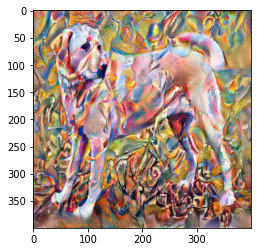

Epoch 19750


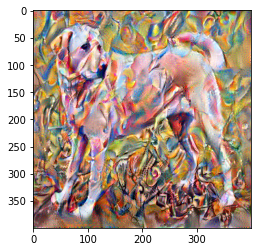

Epoch 20000


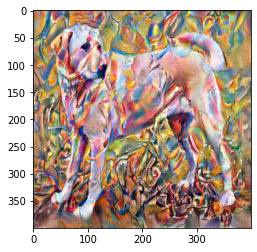

In [107]:
generated_image = tf.Variable(generated_image)
epochs = 20001

for i in range(epochs):
    train_step(generated_image)
    if i % 250 == 0:
        print('Epoch ' + str(i))
        image = tensor_to_image(generated_image)
        plt.imshow(image)
        image.save(f"outputs/Labra{i}.jpg")
        plt.show()

Name of the content:
Buildings.jpg
Name of the style:
Starry_Night.jpg
epoch 0


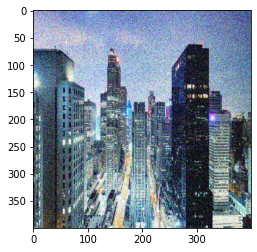

epoch 500


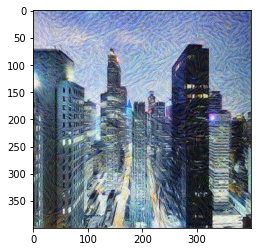

epoch 1000


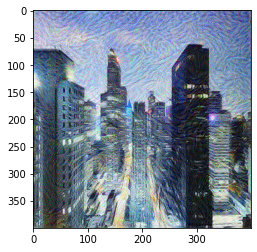

epoch 1500


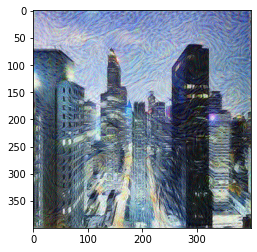

epoch 2000


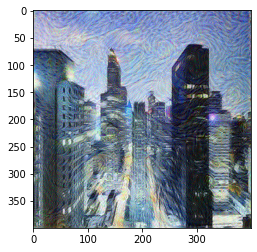

epoch 2500


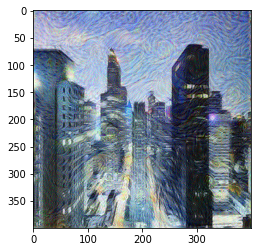

epoch 3000


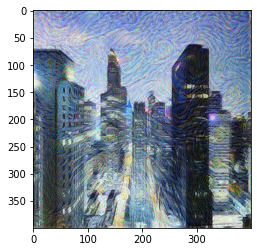

epoch 3500


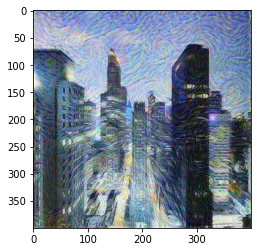

epoch 4000


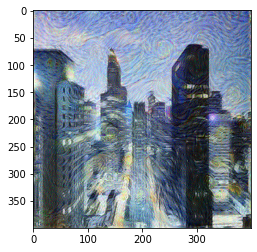

epoch 4500


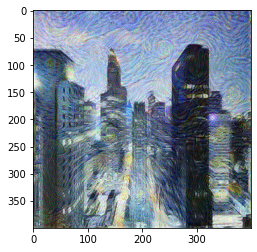

epoch 5000


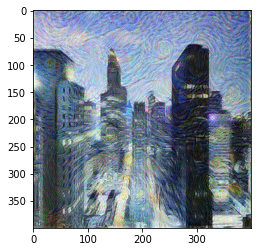

epoch 5500


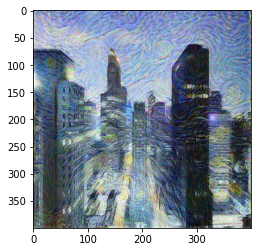

epoch 6000


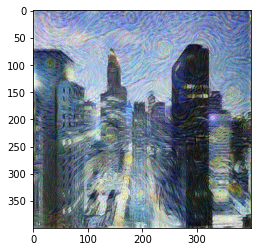

epoch 6500


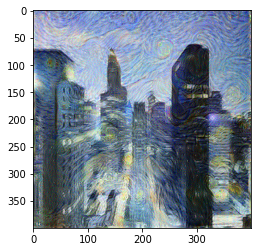

epoch 7000


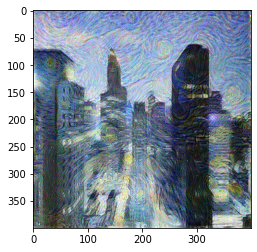

epoch 7500


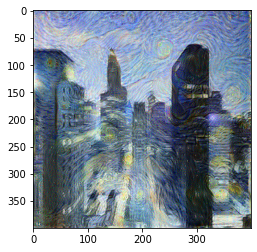

epoch 8000


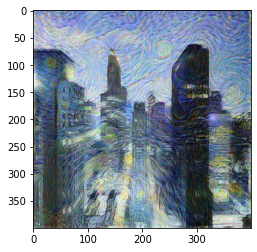

epoch 8500


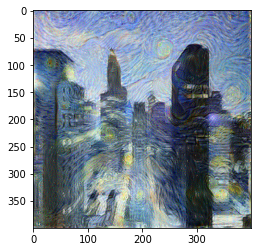

epoch 9000


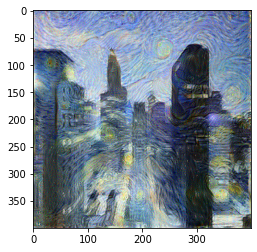

epoch 9500


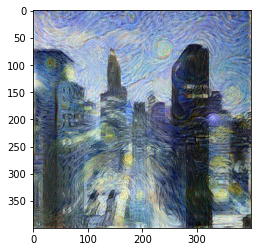

epoch 10000


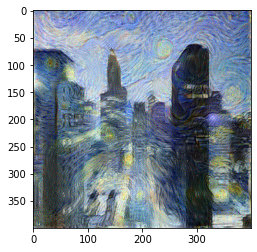

epoch 10500


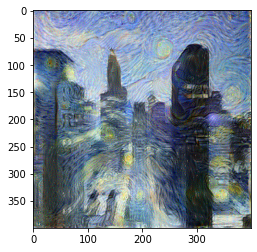

epoch 11000


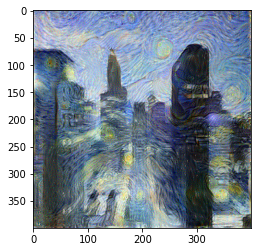

epoch 11500


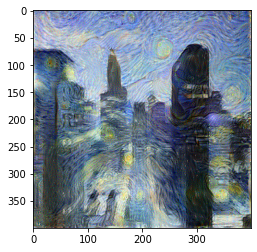

epoch 12000


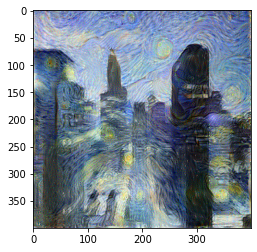

epoch 12500


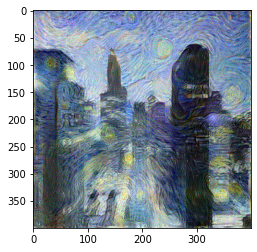

epoch 13000


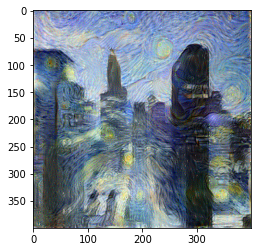

epoch 13500


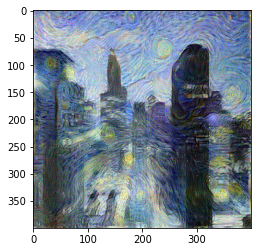

epoch 14000


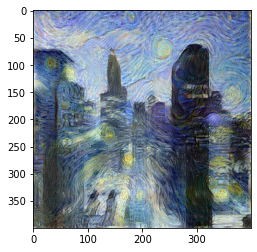

epoch 14500


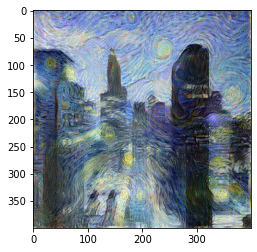

epoch 15000


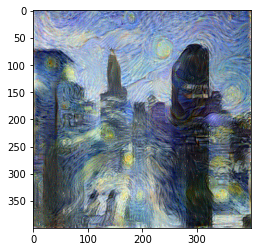

epoch 15500


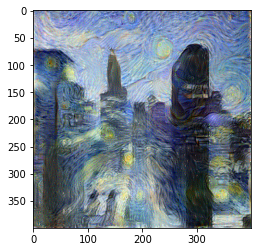

epoch 16000


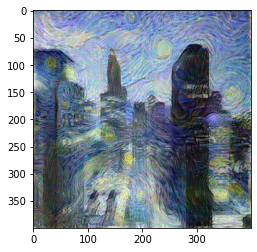

epoch 16500


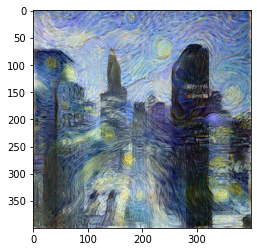

epoch 17000


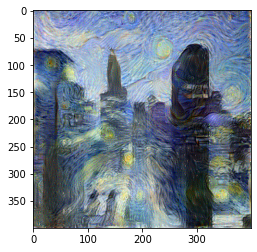

epoch 17500


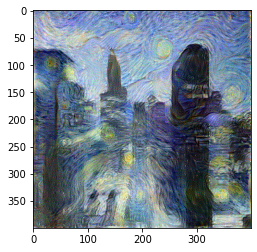

epoch 18000


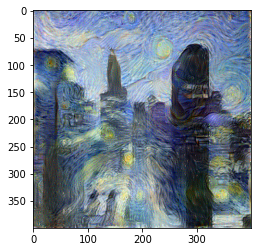

epoch 18500


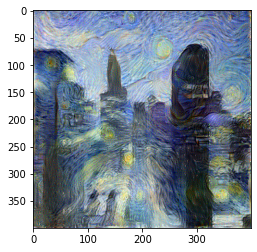

epoch 19000


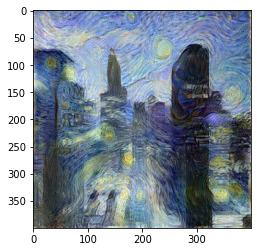

epoch 19500


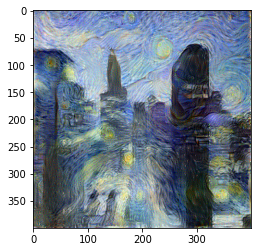

epoch 20000


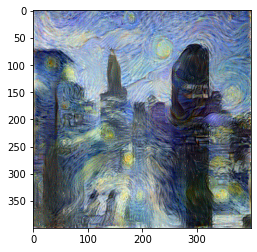

In [31]:
@tf.function()
def train_step(generated_image, optimizer):
    with tf.GradientTape() as tape:
        
        a_G = vgg_model_outputs(generated_image)
        
        J_style = compute_style_cost(a_S, a_G)
        
        J_content = compute_content_cost(a_C, a_G)
        
        J = total_cost(J_content, J_style)
        
    grad = tape.gradient(J, generated_image)
    
    optimizer.apply_gradients([(grad, generated_image)])
    generated_image.assign(clip_0_1(generated_image))
    
    return J

content_path = 'images/content/'
style_path = 'images/style/'

print('Name of the content:')
content = input()

print('Name of the style:')
style = input()

content_Image = np.array(Image.open(os.path.join(content_path, content)).resize((img_size, img_size)))
content_Image = tf.constant(np.reshape(content_Image,((1,) + content_Image.shape)))

style_Image = np.array(Image.open(os.path.join(style_path, style)).resize((img_size, img_size)))
style_Image = tf.constant(np.reshape(style_Image, ((1,) + style_Image.shape)))

generated_image = tf.Variable(tf.image.convert_image_dtype(content_Image, tf.float32))
noise = tf.random.uniform(tf.shape(generated_image), -0.25, 0.25)
generated_image = tf.add(generated_image, noise)
generated_image = tf.clip_by_value(generated_image, clip_value_min = 0.0, clip_value_max = 1.0)

content_layer =[('block5_conv4', 1)]

vgg_model_outputs = get_layer_output(vgg, STYLE_LAYERS + content_layer)

content_target = vgg_model_outputs(content_Image)  #Content encoder
style_target = vgg_model_outputs(style_Image)  #Style encoder

preprocessed_style = tf.Variable(tf.image.convert_image_dtype(content_Image, tf.float32))
a_C = vgg_model_outputs(preprocessed_style)

preprocessed_style = tf.Variable(tf.image.convert_image_dtype(style_Image, tf.float32))
a_S = vgg_model_outputs(preprocessed_style)

generated_image = tf.Variable(generated_image)

optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)

epochs = 20001

for i in range(epochs):
    train_step(generated_image, optimizer)
    if i % 500 == 0:
        image = tensor_to_image(generated_image)
        print(f"epoch {i}")
        plt.imshow(image)
        plt.show()
        image.save(f'outputs/StarryBuilding{i}.jpg')

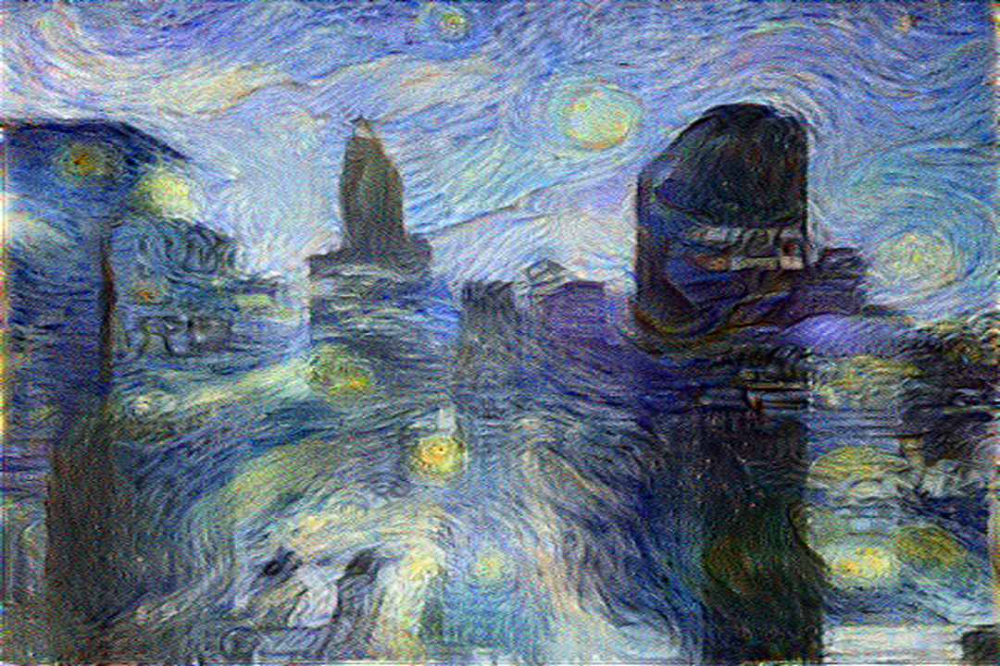

In [33]:
image = image.resize((1080, 720))
image.save('')